# Intro

Welcome to the interactive tracking notebook!\
This notebook goes through each step and allows you to tune parameters and view how it changes the results.

The notebook proceeds as follows:
1. **Import** libraries
2. Define **paths** to data
3. Run data through the **pipeline**. Each step of the pipeline is run by a single unique python class.
4. **Visualize** results
5. **Save** results

As you go through the notebook, take note of the small number of parameters that are mentioned as **'important parameters'** (consider searching for these in the notebook). We consider these to be the only parameters that can have a large effect on the run output. Other parameters matter and should be considered as well, but are less critical.

# Import libraries

Widen the notebook

In [2]:
# widen jupyter notebook window
from IPython.display import display, HTML
display(HTML("<style>.container {width:95% !important; }</style>"))
display(HTML("<style>:root { --jp-notebook-max-width: 100% !important; }</style>"))

Import basic libraries

In [3]:
from pathlib import Path
import copy
import multiprocessing as mp
import tempfile

import matplotlib.pyplot as plt
import numpy as np

Import `roicat`

In [4]:
#weird workaround for multiple copies of OpenMP (linked to importing pytorch)
import os
os.environ['KMP_DUPLICATE_LIB_OK']='TRUE'

In [5]:
import roicat

If you want, you can load existing ROICaT output data below.

When loading has completed, skip straight to 'Visualize results'


# Find paths to data

In this example we are using suite2p output files, but other data types can be used (CaImAn, etc.) \
See the notebook on ingesting diverse data: https://github.com/RichieHakim/ROICaT/blob/main/notebooks/jupyter/other/demo_custom_data_importing.ipynb

Make a list containing the paths to all the input files.

In this example we are using suite2p, so the following are defined:
1. `paths_allStat`: a list to all the stat.npy files
2. `paths_allOps`: a list with ops.npy files that correspond 1-to-1 with the stat.npy files

In [225]:
#define where to look for files
dir_allOuterFolders = r'Y:\Subjects\SP065'

pathSuffixToMLAPDV = 'mpciMeanImage.mlapdv_estimate.npy'
pathSuffixToRFM = '_ibl_passiveRFM.times.npy'

#optionally, exclude some days
days_to_exclude = []
#days_to_exclude = ['2024-10-15'] #for SP065
#days_to_exclude = ['2024-06-21','2024-07-24'] #for SP060
#days_to_exclude = ['2024-06-24','2024-07-15','2024-07-17','2024-08-19','2024-08-20','2024-08-21','2024-08-22'] #for SP058 (these are same sites as originally but 100um deeper)...

In [226]:
#look for all paths that contain MLAPDV datasets
paths_allMLAPDV = roicat.helpers.find_paths(
    dir_outer=dir_allOuterFolders,
    reMatch=pathSuffixToMLAPDV,
    depth=4,
)[:]

#look for all paths that contain Receptive Field Mapping data
paths_allRFM = roicat.helpers.find_paths(
    dir_outer=dir_allOuterFolders,
    reMatch=pathSuffixToRFM,
    depth=4,
)[:]

FOV_paths_all = list(np.unique([(Path(path) / '..').resolve() for path in paths_allMLAPDV]))
RFM_paths_all = list(np.unique([(Path(path) / '..').resolve() for path in paths_allRFM]))

#find paths that contain both the MLAPDV data AND the RFM data
#alf_paths_1 = list(np.unique([(Path(path) / '..').resolve() for path in FOV_paths_all]))
#alf_paths_2 = list(np.unique([(Path(path) / '..').resolve() for path in RFM_paths_all]))
#alf_paths_full = list(np.unique(list(set(alf_paths_1).intersection(set(alf_paths_2)))))

#alternatively, find paths that contain ONLY the MLAPDV data
alf_paths_full = list(np.unique([(Path(path) / '..').resolve() for path in FOV_paths_all]))

#exclude the buggy days
alf_paths = list([Path(path).resolve() for path in alf_paths_full if not any(d in path.__str__() for d in days_to_exclude)])

In [237]:
import os
import ipywidgets as widgets
from IPython.display import display

# Create & display a file selector widget
print('Uncheck the sessions you do NOT want to use:')
unique_paths = list(np.unique([(Path(path) / '..').resolve() for path in alf_paths]))
checkboxes = [widgets.Checkbox(value=True, description=str(p), layout=widgets.Layout(width="40%")) for p in unique_paths]
output = widgets.VBox(children=checkboxes)

display(output)

# Add a button to save selected paths
sel_button = widgets.Button(description="Confirm selection")
display(sel_button)

def on_save_button_clicked(b):
    global sel_paths
    sel_paths = []
    for i in range(0, len(checkboxes)):
        if checkboxes[i].value == True:
            sel_paths = sel_paths + [checkboxes[i].description]

sel_button.on_click(on_save_button_clicked)

Uncheck the sessions you do NOT want to use:


Button(description='Confirm selection', style=ButtonStyle())

In [230]:
data = ["data1", "data2", "data3", "data4"]
checkboxes = [widgets.Checkbox(value=True, description=label) for label in data]
output = widgets.VBox(children=checkboxes)
display(output)

selected_data = []
for i in range(0, len(checkboxes)):
    if checkboxes[i].value == True:
        selected_data = selected_data + [checkboxes[i].description]
print(selected_data)

['data1', 'data2', 'data3', 'data4']


In [218]:
#get the updated MLAPDV & FOV paths
paths_MLAPDV = []
FOV_paths = []
for p in sel_paths:
    paths_MLAPDV += roicat.helpers.find_paths(dir_outer=p,reMatch=pathSuffixToMLAPDV,depth=2)[:]

FOV_paths = [(Path(path) / '..').resolve() for path in paths_MLAPDV]

In [8]:
#figure out the candidate repeated sites using the MLAPDV data
MLAPDVs = np.array([np.load(mlapdv_path) for mlapdv_path in paths_MLAPDV])
MLAPDVs_means = np.mean(MLAPDVs, axis=(1,2))
u, u_idxs, cnts = np.unique(MLAPDVs_means,axis=0, return_inverse=True, return_counts=True)
uIdxs_repSites = np.where(cnts>2)[0]

for i,uu in enumerate(uIdxs_repSites):
    print('\ncandidate site '+str(uu)+' ('+str(len(np.array(FOV_paths)[u_idxs==uu]))+' sessions):')
    print([str(p)[-25:] for p in np.array(FOV_paths)[u_idxs==uu]])


candidate site 0 (9 sessions):
['2024-10-14\\001\\alf\\FOV_05', '2024-10-15\\001\\alf\\FOV_05', '2024-10-16\\001\\alf\\FOV_05', '2024-10-17\\001\\alf\\FOV_05', '2024-10-18\\001\\alf\\FOV_05', '2024-10-21\\002\\alf\\FOV_05', '2024-10-23\\001\\alf\\FOV_05', '2024-10-24\\001\\alf\\FOV_05', '2024-10-28\\001\\alf\\FOV_05']

candidate site 1 (9 sessions):
['2024-10-14\\001\\alf\\FOV_04', '2024-10-15\\001\\alf\\FOV_04', '2024-10-16\\001\\alf\\FOV_04', '2024-10-17\\001\\alf\\FOV_04', '2024-10-18\\001\\alf\\FOV_04', '2024-10-21\\002\\alf\\FOV_04', '2024-10-23\\001\\alf\\FOV_04', '2024-10-24\\001\\alf\\FOV_04', '2024-10-28\\001\\alf\\FOV_04']

candidate site 2 (9 sessions):
['2024-10-14\\001\\alf\\FOV_03', '2024-10-15\\001\\alf\\FOV_03', '2024-10-16\\001\\alf\\FOV_03', '2024-10-17\\001\\alf\\FOV_03', '2024-10-18\\001\\alf\\FOV_03', '2024-10-21\\002\\alf\\FOV_03', '2024-10-23\\001\\alf\\FOV_03', '2024-10-24\\001\\alf\\FOV_03', '2024-10-28\\001\\alf\\FOV_03']

candidate site 3 (9 sessions):
['202

In [128]:
#CHOOSE A CANDIDATE SITE FROM THE LIST ABOVE
candidate_selection = 5 # put the index of your chosen candidate site
fov_name = 'FOV_00'; #this is just for saving. Usually the FOV_xx name of the majority of sessions
subject = 'SP065'; #this is just for saving. Check this corresponds to the loaded datasets.

In [129]:
#unzip the raw suite2p files for this candidate site

idxs = np.where(u_idxs==candidate_selection)
paths_toFOVs = np.array(FOV_paths)[idxs]

pathSuffixToS2p =  '_suite2p_ROIData.raw'

import zipfile, os
for p in np.array(FOV_paths)[idxs]:
    p_extractfrom = p / (pathSuffixToS2p + '.zip')
    p_extractto = p / pathSuffixToS2p
    if os.path.exists(p_extractto):
        print(str(p) + ': was already extracted!')
    else:
        print(str(p) + ': unzipping...')
        with zipfile.ZipFile(p_extractfrom, 'r') as zip_ref:
            zip_ref.extractall(p_extractto)

\\128.40.198.163\ibldata\Subjects\SP065\2024-10-14\001\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-15\001\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-16\001\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-17\001\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-18\001\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-21\002\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-23\001\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-24\001\alf\FOV_00: unzipping...
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-28\001\alf\FOV_00: unzipping...


In [130]:
pathSuffixToStat = 'stat.npy'
pathSuffixToOps = 'ops.npy'
pathSuffixToIscell = 'iscell.npy'

paths_s2p = [path.joinpath(pathSuffixToS2p) for path in np.array(FOV_paths)[idxs]]
paths_allStat = [path.joinpath(pathSuffixToStat) for path in paths_s2p]
paths_allOps = [path.joinpath(pathSuffixToOps) for path in paths_s2p]
paths_allIscell = [path.joinpath(pathSuffixToIscell) for path in paths_s2p]

print(f'paths to all stat files:');
[print(path) for path in paths_allStat];
print('');

In [132]:
# make a new stat array which selects only ROIs that are cells
pathSuffixToStatIscell = 'stat_cell.npy'

class_thresh = 0.5 #change this threshold
for i,path in enumerate(paths_allIscell):
    stat = np.load(paths_allStat[i], allow_pickle=True)
    iscell = np.load(path, allow_pickle=True)
    #stat_iscell = stat[iscell[:,1]>class_thresh] #METHOD 1: set a classifier threshold
    stat_iscell = stat[np.array(iscell[:,0], dtype=bool)] #METHOD 2: use the boolean of the iscell array
    p = os.path.dirname(path)
    #np.save(p+'\\'+pathSuffixToStatIscell, stat_iscell, allow_pickle=True)
    
paths_allStat_iscell = [path.joinpath(pathSuffixToStatIscell) for path in paths_s2p]

In [133]:
#paths_selStat = [str(p) for p in paths_allStat_iscell] #take only ROIs where iscell=True
paths_selStat = [str(p) for p in paths_allStat] #take all ROIs
paths_selOps = [str(p) for p in paths_allOps]

print(f'paths to all stat files:');
[print(path) for path in paths_selStat];
print('');
print(f'paths to all ops files:');
[print(path) for path in paths_selOps];
print('');

paths to all stat files:
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-14\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-15\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-16\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-17\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-18\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-21\002\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-23\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-24\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-28\001\alf\FOV_00\_suite2p_ROIData.raw\stat.npy

paths to all ops files:
\\128.40.198.163\ibldata\Subjects\SP065\2024-10-14\001\alf\FOV_00\_suite2p_ROIData.raw

# Import data

**Important parameters**:
- `um_per_pixel` (float):
    - Resolution. 'micrometers per pixel' of the imaging field of view.

In [134]:
data = roicat.data_importing.Data_suite2p(
    paths_statFiles=paths_selStat[:],
    paths_opsFiles=paths_selOps[:],
    um_per_pixel=1.2,  ## IMPORTANT PARAMETER
    new_or_old_suite2p='new',
    type_meanImg='meanImgE',
#     FOV_images=FOVs_mixed,

    verbose=True,
)

assert data.check_completeness(verbose=False)['tracking'], f"Data object is missing attributes necessary for tracking."

C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\roicat\util.py:416: UserWarning: RH WARNING: unable to get gcc version. Got error: [WinError 2] The system cannot find the file specified
  warnings.warn(f'RH WARNING: unable to get gcc version. Got error: {e}')


Starting: Importing FOV images from ops files
Completed: Set FOV_height and FOV_width successfully.
Completed: Imported 9 FOV images.
Setting FOV_images...
Completed: Set FOV_images for 9 sessions successfully.
Importing spatial footprints from stat files.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:03<00:00,  2.57it/s]


Imported 9 sessions of spatial footprints into sparse arrays.
Completed: Set spatialFootprints for 9 sessions successfully.
Completed: Created session_bool.
Completed: Created centroids.
Starting: Creating centered ROI images from spatial footprints...
Completed: Created ROI images.


**Note on subselecting ROIs**:

Generally, I recommend the following:
- Do not subselecting ROIs prior to tracking. Use all available ROIs for the entire tracking process.
- Then, after tracking, subsequently apply classification and inclusion criteria to remove bad ROIs. See the 'tracking_handling_outputs.ipynb' notebook for details.

However, if you want to subselect ROIs before tracking you can call `data.remove_ROIs_by_classLabel()`. Prior to doing this, you will first need to set the class labels in the `data` object by either calling `data.set_class_labels()` or providing the `paths_iscell` input argument (if using the `Data_suite2p` class). Code below:

```python
data.remove_rois_by_classLabel(classLabel_to_keep=1, verbose=True)
```


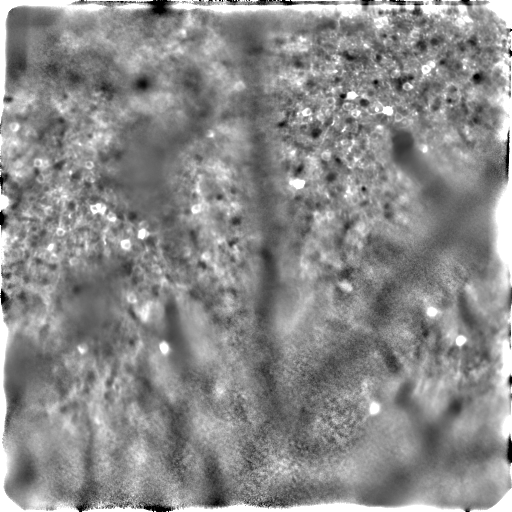


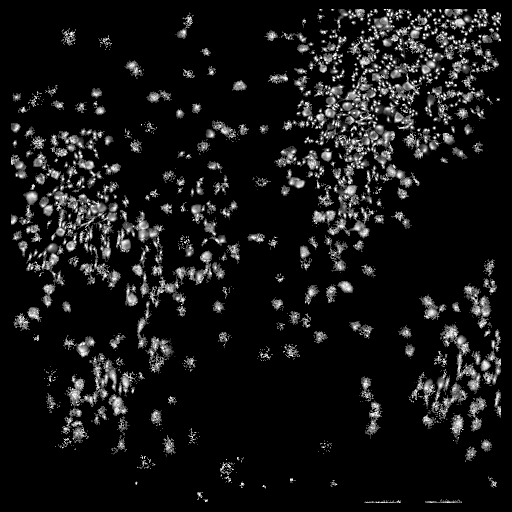


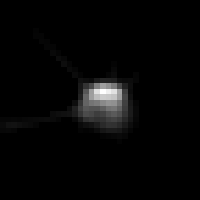

In [135]:
roicat.visualization.display_toggle_image_stack(data.FOV_images)
roicat.visualization.display_toggle_image_stack(data.get_maxIntensityProjection_spatialFootprints(), clim=[0,1])
roicat.visualization.display_toggle_image_stack(np.concatenate(data.ROI_images, axis=0)[:5000], image_size=(200,200))

### Set the device to run on

If you have a GPU, some steps can be sped up.

In [136]:
DEVICE = roicat.helpers.set_device(use_GPU=True)

Using device: cuda:0


### Set determinism and seed
Perfect determinism is not possible for a variety of reasons, but by setting `deterministic` to True you can get close by forcing the backend code to use deterministic algorithms where possible. It is generally not recommended to use deterministic algorithms and seeds due to the potential for reproducing low probability outputs and slower computation. Though, it can be useful in recreating bugs. If you want to do so, you can set the `deterministic` parameter to `True` below.

In [137]:
SEED = roicat.util.set_random_seed(seed=None, deterministic=False)  ## Deterministic algorithms have issues, but are useful for debugging, testing, and reproducing results.

# Alignment

This is the most important step in the pipeline to stop and check that everything looks okay and tune parameters if necessary. I strongly recommend reading the documentation for the methods for the `roicat.tracking.alignment.Aligner` class at each step.

Alignment is 4 steps:

1. FOV_image augmentation
2. Fit geometric transformation
3. Fit non-rigid transformation (on top of the geometric)
4. Apply transformation to ROIs

##### 1. FOV_image augmentation
Do what is necessary to make the augmented FOV_images look good. Use the visualization tool below to help. This can include playing with the mixing factor, normalization, and playing with the CLAHE parameters.

In [138]:
aligner = roicat.tracking.alignment.Aligner(
    use_match_search=True,  ## Use our algorithm for doing all-pairs matching if template matching fails.
    all_to_all=False,  ## Force the use of our algorithm for all-pairs matching. Much slower (False: O(N) vs. True: O(N^2)), but more accurate.
    radius_in=4,  ## IMPORTANT PARAMETER: Value in micrometers used to define the maximum shift/offset between two images that are considered to be aligned. Larger means more lenient alignment.
    radius_out=20,  ## Value in micrometers used to define the minimum shift/offset between two images that are considered to be misaligned.
    z_threshold=4.0,  ## IMPORTANT PARAMETER: Z-score required to define two images as aligned. Larger values results in more stringent alignment requirements.
    um_per_pixel=data.um_per_pixel[0],  ## Single value for um_per_pixel. data.um_per_pixel is typically a list of floats, so index out just one value.
    device=DEVICE,
    verbose=True,
)

C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\roicat\util.py:416: UserWarning: RH WARNING: unable to get gcc version. Got error: [WinError 2] The system cannot find the file specified
  warnings.warn(f'RH WARNING: unable to get gcc version. Got error: {e}')


In [139]:
FOV_images = aligner.augment_FOV_images(
    FOV_images=data.FOV_images,
    spatialFootprints=data.spatialFootprints,
    normalize_FOV_intensities=True,
    roi_FOV_mixing_factor=0.5,
    use_CLAHE=True,  ## IMPORTANT PARAMETER. Use Set to False if data is poor quality or poorly aligned.
    CLAHE_grid_block_size=10,  ## IMPORTANT PARAMETER. Use smaller values for higher precision but higher chance of failure.
    CLAHE_clipLimit=1.0,
    CLAHE_normalize=True,
)

View the augmented FOV images


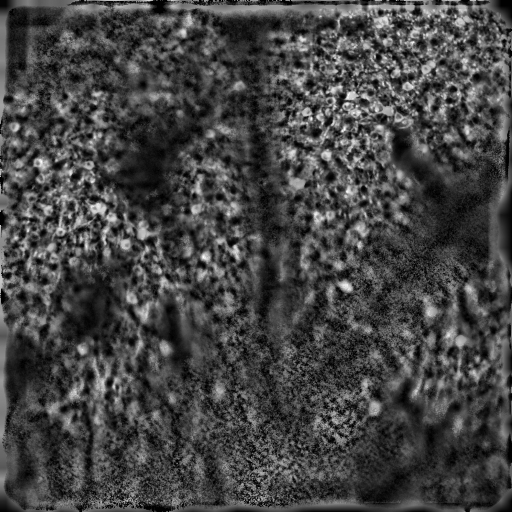

In [140]:
roicat.visualization.display_toggle_image_stack(FOV_images)

##### 2. Fit geometric transformation
This is an important step. Consider reading the comments and arguments closely.

Play with parameters until the aligned FOV_images look good. The visualization tool below can help.

This step creates the attribute: `aligner.ims_registered_geo`, which are the registered images after the geometric transformation.

We like the following **important parameters**:
- `template`=0.5

In [141]:
aligner.fit_geometric(
    template=0.5,  ## specifies which image to use as the template. Either array (image), integer (ims_moving index), or float (ims_moving fractional index)
    ims_moving=FOV_images,  ## input images
    template_method='image',  ## 'sequential': align images to neighboring images (good for drifting data). 'image': align to a single image
    mask_borders=(0, 0, 0, 0),  ## number of pixels to mask off the edges (top, bottom, left, right)
    method='DISK_LightGlue',  ## See below for options.
    kwargs_method = {
        'RoMa': {  ## Accuracy: Best, Speed: Very slow (can be fast with a GPU).
            'model_type': 'outdoor',
            'n_points': 10000,  ## Higher values mean more points are used for the registration. Useful for larger FOV_images. Larger means slower.
            'batch_size': 1000,
        },
        'DISK_LightGlue': {  ## Accuracy: Good, Speed: Fast.
            'num_features': 3000,  ## Number of features to extract and match. I've seen best results around 2048 despite higher values typically being better.
            'threshold_confidence': 0.0,  ## Higher values means fewer but better matches.
            'window_nms': 7,  ## Non-maximum suppression window size. Larger values mean fewer non-suppressed points.
        },
        'LoFTR': {  ## Accuracy: Okay. Speed: Medium.
            'model_type': 'indoor_new',
            'threshold_confidence': 0.2,  ## Higher values means fewer but better matches.
        },
        'ECC_cv2': {  ## Accuracy: Okay. Speed: Medium.
            'mode_transform': 'euclidean',  ## Must be one of {'translation', 'affine', 'euclidean', 'homography'}. See cv2 documentation on findTransformECC for more details.
            'n_iter': 200,
            'termination_eps': 1e-09,  ## Termination criteria for the registration algorithm. See documentation for more details.
            'gaussFiltSize': 1,  ## Size of the gaussian filter used to smooth the FOV_image before registration. Larger values mean more smoothing.
            'auto_fix_gaussFilt_step': 10,  ## If the registration fails, then the gaussian filter size is reduced by this amount and the registration is tried again.
        },
        'PhaseCorrelation': {  ## Accuracy: Poor. Speed: Very fast. Notes: Only applicable for translations, not rotations or scaling.
            'bandpass_freqs': [1, 30],
            'order': 5,
        },
    },
    kwargs_RANSAC = {
        'inl_thresh': 3.0,  ## cv2.findHomography RANSAC inlier threshold. Larger values mean more lenient matching.
        'max_iter': 100,
        'confidence': 0.99,
    },
    verbose=True,  ## Set to 3 to view plots of the alignment process if available for the method.
);

Loaded LightGlue model
Converting float fractional index to integer index: 0.5 -> 4


Finding geometric registration warps:   0%|          | 0/9 [00:00<?, ?it/s]

Alignment z_in scores: [18.6, 12.3, 17.0, 10.6, 8055487488.0, 38.8, 22.7, 10.3, 38.6]. z_threshold: 4.0.
All images aligned successfully!


Plot the alignment scores. The '(final)' score is the alignment score between a pair of images given the final compsed geometric transformation between them. The '(direct)' score (only shown if the match search algorithm was used) is the alignment score between a pair of images given the single direct geometric transformation between them.

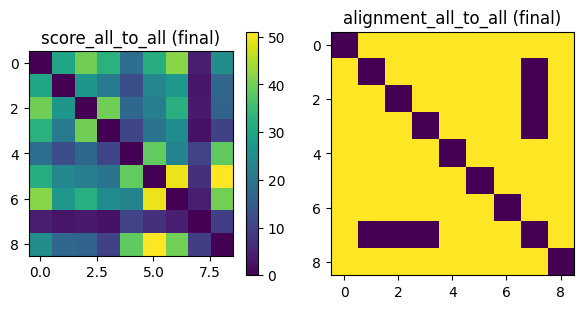

In [142]:
aligner.plot_alignment_results_geometric();

##### 3. Fit non-rigid transformation
Play with parameters until the aligned FOV_images look good. The visualization tool below can help.

We like the following **important parameters**:
- `template`=0.5
- `template_method`='image'


In [143]:
aligner.fit_nonrigid(
    template=0.5,  ## specifies which image to use as the template. Either array (image), integer (ims_moving index), or float (ims_moving fractional index)
    ims_moving=aligner.ims_registered_geo,  ## Input images. Typically the geometrically registered images
    remappingIdx_init=aligner.remappingIdx_geo,  ## The remappingIdx between the original images (and ROIs) and ims_moving
    template_method='image',  ## 'sequential': align images to neighboring images. 'image': align to a single image, good if using geometric registration first
    method='DeepFlow',
    kwargs_method = {
        'DeepFlow': {},  ## Accuracy: Good (good in middle, poor on edges), Speed: Fast (CPU only)
        'RoMa': {  ## Accuracy: Okay (decent in middle, poor on edges), Speed: Slow (can be fast with a GPU), Notes: This method can work on the raw images without pre-registering using geometric methods.
            'model_type': 'outdoor',
        },
        'OpticalFlowFarneback': {  ## Accuracy: Varies (can sometimes be tuned to be the best as there are no edge artifacts), Speed: Medium (CPU only)
            'pyr_scale': 0.7,
            'levels': 5,
            'winsize': 256,
            'iterations': 15,
            'poly_n': 5,
            'poly_sigma': 1.5,            
        },
    },    
)

aligner.transform_images_nonrigid(FOV_images);

Converting float fractional index to integer index: 0.5 -> 4
Finding nonrigid registration warps with mode: DeepFlow, template_method: image


Finding nonrigid registration warps:   0%|          | 0/9 [00:00<?, ?image/s]

Composing nonrigid warp matrices...
Applying nonrigid registration warps to images...


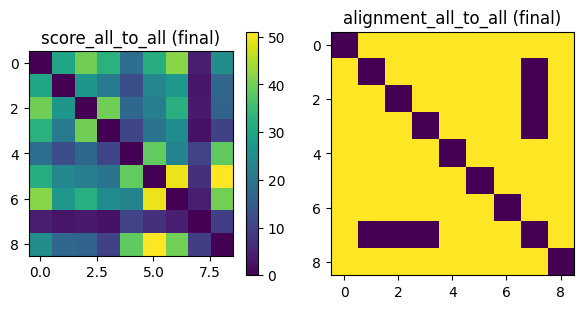

In [144]:
aligner.plot_alignment_results_nonrigid();

##### 4. Transform ROIs

In [145]:
aligner.transform_ROIs(
    ROIs=data.spatialFootprints, 
    remappingIdx=aligner.remappingIdx_nonrigid,
    # remappingIdx=aligner.remappingIdx_geo,
    normalize=True,
);

Registering ROIs...


Registering ROIs:   0%|          | 0/9 [00:00<?, ?it/s]

Ensure that the aligned FOVs look aligned

Pre-alignment below



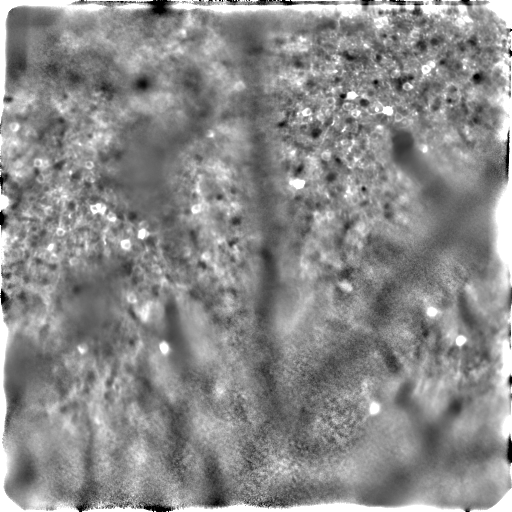

Geometric alignment below



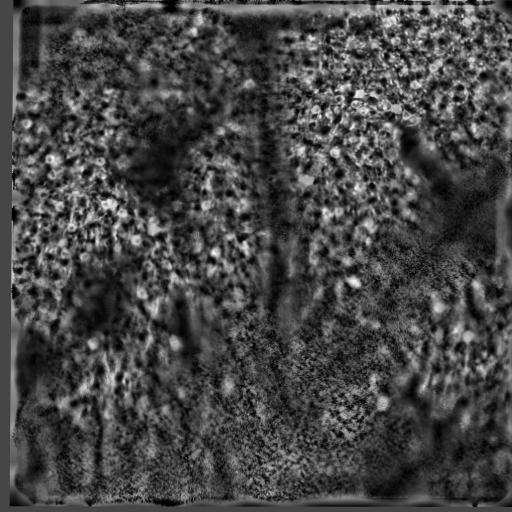

Non-rigid alignment below



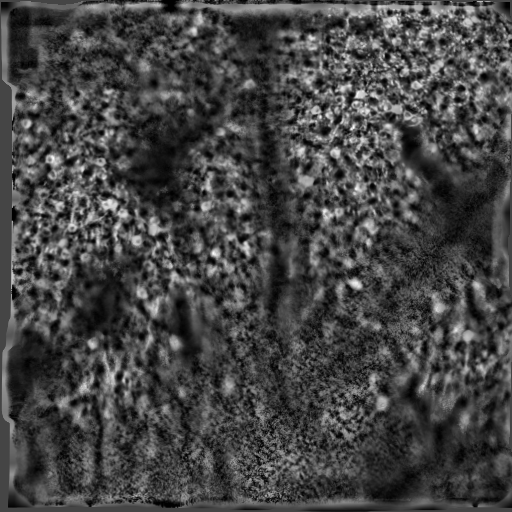

Transformed ROIs below (max intensity projection)



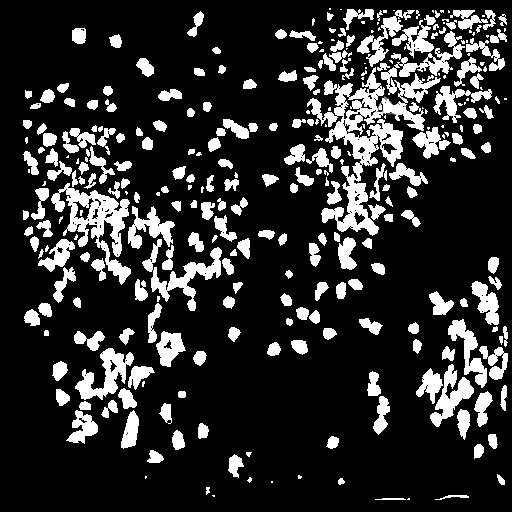

In [146]:
print(f'Pre-alignment below')
roicat.visualization.display_toggle_image_stack(data.FOV_images)
print(f'Geometric alignment below')
roicat.visualization.display_toggle_image_stack(aligner.ims_registered_geo)
print(f'Non-rigid alignment below')
roicat.visualization.display_toggle_image_stack(aligner.ims_registered_nonrigid)
print(f'Transformed ROIs below (max intensity projection)')
roicat.visualization.display_toggle_image_stack(aligner.get_ROIsAligned_maxIntensityProjection(), clim=(0, 0.05))

# Blur ROIs

ROIs from different sessions with zero spatial overlap have very low probability of being considered the same ROI. Blurring the spatial footprint masks can increase the overlap between ROIs that drift apart from each other. 

Preparing the Toeplitz convolution matrix
Performing convolution for blurring


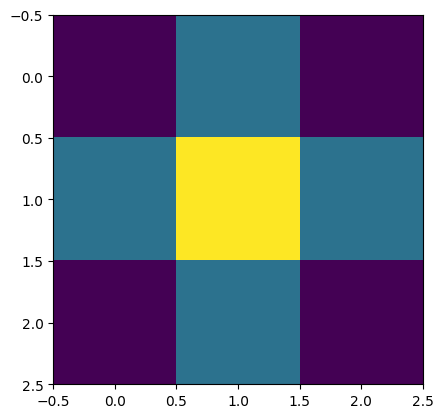

In [147]:
blurrer = roicat.tracking.blurring.ROI_Blurrer(
    frame_shape=(data.FOV_height, data.FOV_width),  ## FOV height and width
    kernel_halfWidth=2,  ## The half width of the 2D gaussian used to blur the ROI masks
    plot_kernel=True,  ## Whether to visualize the 2D gaussian
)

blurrer.blur_ROIs(
    spatialFootprints=aligner.ROIs_aligned[:],
);

See that the blurred ROIs are overlapping each other


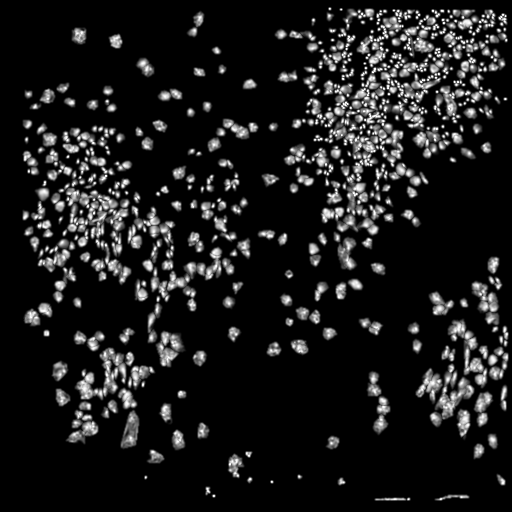

In [148]:
roicat.visualization.display_toggle_image_stack(blurrer.get_ROIsBlurred_maxIntensityProjection())

# ROInet embedding

This step passes the images of each ROI through the ROInet neural network. The inputs are the images, the output is an array describing the visual properties of each ROI.

Initialize the ROInet object. The `ROInet_embedder` class will automatically download and load a pretrained ROInet model. If you have a GPU, this step will be much faster.

In [149]:
#DEVICE = roicat.helpers.set_device(use_GPU=True, verbose=True)
dir_temp = tempfile.gettempdir()

roinet = roicat.ROInet.ROInet_embedder(
    device=DEVICE,  ## Which torch device to use ('cpu', 'cuda', etc.)
    dir_networkFiles=dir_temp,  ## Directory to download the pretrained network to
    download_method='check_local_first',  ## Check to see if a model has already been downloaded to the location (will skip if hash matches)
    download_url='https://osf.io/x3fd2/download',  ## URL of the model
    download_hash='7a5fb8ad94b110037785a46b9463ea94',  ## Hash of the model file
    forward_pass_version='latent',  ## How the data is passed through the network
    verbose=True,  ## Whether to print updates
)

File already exists locally: C:\Users\Samuel\AppData\Local\Temp\ROInet.zip
Hash of local file matches provided hash_hex.
Extracting C:\Users\Samuel\AppData\Local\Temp\ROInet.zip to C:\Users\Samuel\AppData\Local\Temp.
Completed zip extraction.
Imported model from C:\Users\Samuel\AppData\Local\Temp\ROInet_tracking_20220527\model.py
Loaded params_model from C:\Users\Samuel\AppData\Local\Temp\ROInet_tracking_20220527\params.json


C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1`. You can also use `weights=ConvNeXt_Tiny_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Generated network using params_model
Loaded state_dict into network from C:\Users\Samuel\AppData\Local\Temp\ROInet_tracking_20220527\ConvNext_tiny__1_0_best__simCLR.pth
Loaded network onto device cuda:0


Resize ROIs and prepare a dataloader.

**Important parameters**:
- `um_per_pixel`: (same as specified in `data` object). Resolution of FOV. This is used to resize the ROIs to be relatively consistent across resolutions.

In [150]:
roinet.generate_dataloader(
    ROI_images=data.ROI_images,  ## Input images of ROIs
    um_per_pixel=data.um_per_pixel,  ## Resolution of FOV
    pref_plot=False,  ## Whether or not to plot the ROI sizes
    
    jit_script_transforms=False,  ## (advanced) Whether or not to use torch.jit.script to speed things up
    
    batchSize_dataloader=8,  ## (advanced) PyTorch dataloader batch_size
    pinMemory_dataloader=True,  ## (advanced) PyTorch dataloader pin_memory
    numWorkers_dataloader=mp.cpu_count(),  ## (advanced) PyTorch dataloader num_workers
    persistentWorkers_dataloader=True,  ## (advanced) PyTorch dataloader persistent_workers
    prefetchFactor_dataloader=2,  ## (advanced) PyTorch dataloader prefetch_factor
);

Starting Image Resizer
Creating dataloader
Defined image transformations: Sequential(
  (0): ScaleDynamicRange(scaler_bounds=(0, 1))
  (1): Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
  (2): TileChannels(dim=0)
)
Defined dataset
Defined dataloader


In general, you want to see that a neuron fills roughly 25-50% of the area of the image.


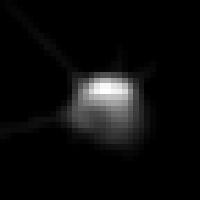

In [151]:
roicat.visualization.display_toggle_image_stack(roinet.ROI_images_rs[:1000], image_size=(200,200))

Pass the data through the network. Expect for large datasets (~40,000 ROIs) that this takes around 15 minutes on CPU or 1 minute on GPU.

In [152]:
roinet.generate_latents();

starting: running data through network


  0%|          | 0/1437 [00:01<?, ?it/s]

completed: running data through network


# Scattering wavelet embedding

This is similar to the ROInet embedding in purpose.

In [153]:
swt = roicat.tracking.scatteringWaveletTransformer.SWT(
    kwargs_Scattering2D={'J': 2, 'L': 12},  ## 'J' is the number of convolutional layers. 'L' is the number of wavelet angles.
    image_shape=data.ROI_images[0].shape[1:3],  ## size of a cropped ROI image
    device=DEVICE,  ## PyTorch device
)

swt.transform(
    ROI_images=roinet.ROI_images_rs,  ## All the cropped and resized ROI images
    batch_size=100,  ## Batch size for each iteration (smaller is less memory but slower)
);

SWT initialized
Starting: SWT transform on ROIs


 51%|█████████████████████████████████████████████████████▉                                                   | 59/114.96 [00:05<00:04, 11.78it/s]C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\tqdm\std.py:636: TqdmWarning: clamping frac to range [0, 1]
  full_bar = Bar(frac,
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 115/114.96 [00:09<00:00, 11.80it/s]


Completed: SWT transform on ROIs


# Compute similarities

Now we can compare the similarities of the ROIs. This includes calculating 4 kinds of similarities:
1. `s_sf`: 'similarity spatial footprint'. The physical overlap between ROIs.
2. `s_NN`: 'similarity neural network'. The similarities of the embeddings out of ROInet.
3. `s_SWT`: 'similarity scaterring wavelet transform'. The similarities of the embeddings out of the scattering wavelet transformer.
4. `s_sesh`: 'similarity sessions'. 0 if from the same session, 1 if from different sessions. ROIs from the same session have 0 probability of being the same.

The result of this step will be a set of pairwise similarity matrices.

Initialize the `ROI_graph` class and compute similarities.
To make computation more efficient, only ROIs within the same 'block' are compared against each other.

Computing pairwise similarity between ROIs...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:04<00:00,  3.31it/s]


Joining blocks into full similarity matrices...
Joining s_sf...
Joining s_NN...
Joining s_SWT...
Joining s_sesh...


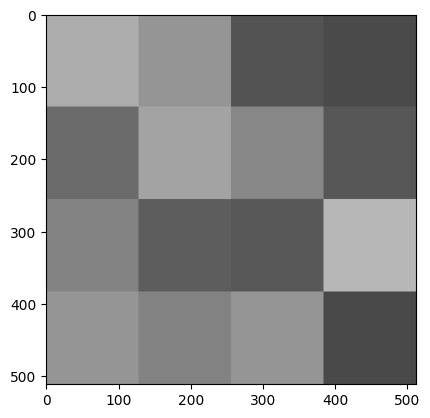

In [154]:
sim = roicat.tracking.similarity_graph.ROI_graph(
    n_workers=-1,  ## Number of CPU cores to use. -1 for all.
    frame_height=data.FOV_height,
    frame_width=data.FOV_width,
    block_height=128,  ## size of a block
    block_width=128,  ## size of a block
    algorithm_nearestNeigbors_spatialFootprints='brute',  ## algorithm used to find the pairwise similarity for s_sf. ('brute' is slow but exact. See docs for others.)
    verbose=True,  ## Whether to print outputs
)

sim.visualize_blocks()

s_sf, s_NN, s_SWT, s_sesh = sim.compute_similarity_blockwise(
    spatialFootprints=blurrer.ROIs_blurred,  ## Mask spatial footprints (blurred)
    #spatialFootprints=aligner.ROIs_aligned[:],  ## Mask spatial footprints (raw)
    features_NN=roinet.latents,  ## ROInet output latents
    features_SWT=swt.latents,  ## Scattering wavelet transform output latents
    ROI_session_bool=data.session_bool,  ## Boolean array of which ROIs belong to which sessions
    spatialFootprint_maskPower=1.0,  ##  An exponent to raise the spatial footprints to to care more or less about bright pixels
);

It is useful to normalize the similarity matrices using the local ROIs.

In [155]:
sim.make_normalized_similarities(
    centers_of_mass=data.centroids,  ## ROI centroid positions
    features_NN=roinet.latents,  ## ROInet latents
    features_SWT=swt.latents,  ## SWT latents
    k_max=data.n_sessions*100,  ## Maximum number of nearest neighbors to consider for the normalizing distribution
    k_min=data.n_sessions*10,  ## Minimum number of nearest neighbors to consider for the normalizing distribution
    algo_NN='kd_tree',  ## Nearest neighbors algorithm to use
    device=DEVICE,
)

Finding k-range of center of mass distance neighbors for each ROI...
Normalizing Neural Network similarity scores...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 11496/11496 [00:01<00:00, 6751.78it/s]


Normalizing SWT similarity scores...


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 11496/11496 [00:13<00:00, 826.30it/s]


# Clustering

This step does the following:
1. Mix the similarity matrices into a single distance matrix
2. Prune the distance matrix to remove low probability connections
3. Perform clustering
4. Compute quality metrics

#### 1. Mix the similarity matrices into a single distance matrix

This step can be done either automatically, using the `clusterer.find_optimal_parameters_for_pruning` method, or manually by specifying the `kwargs_makeConjunctiveDistanceMatrix` dictionary.


##### Option A: Automatic Method
This step finds the optimal parameters to mix the similarity matrices by tuning mixing parameters to maximally separate the distributions of pairwise similarities for ROI pairs known to be different and ROI pairs that are likely matched.

Some of the details of underlying algorithm:
1. For each step in the optimization process, all the similarity matrices (`s_sf`, `s_NN_z`, `s_SWT_z`, `s_sesh`) are each passed through a sigmoid activation function that is parameterized (e.g. `'power_SF'`, `'sig_SF_kwargs'`), then all the similarity matrices are combined using a p-norm, where the 'p' is parameterized with `'p_norm'`. This results in a single conjunctive similarity matrix called `sConj` bounded between 0-1. 
2. `sConj` is converted into a distance matrix `dConj` (bounded from 1-0).
3. `dConj` is then passed through the objective function: The full distance matrix is separated into a few components. First, all pairs of ROIs that are known to be from 'different' sources because they are from the same session are separated out into a distribution of pairwise distances (`d_diff`). Second, we define pairs of ROIs that are likely to be from the same source as `d_same` = `d_all` - `d_diff`. The objective function is then the overlap between the `d_diff` and `d_same` distributions. 
4. The objective function is minimized by tuning the mixing parameters in `kwargs_makeConjunctiveDistanceMatrix`.
5. The output of this step is the optimal `kwargs_makeConjunctiveDistanceMatrix` dictionary.

##### Option B: Manual Method
You can also simply specify the `kwargs_makeConjunctiveDistanceMatrix` dictionary manually. This is useful if you have a good idea of what the optimal parameters are or if the automatic method is not working well. Uncomment the code block below to overwrite the `kwargs_mcdm_tmp` variable.

#### TROUBLESHOOTING FOR THIS STEP
- If you have any issues, just email Rich Hakim or open an issue on the github issues page.
- If you see: `'No crossover found, not plotting'`: Your data may not be easily separable. For some people, this is because the number of matching ROIs is very low compared to the number of non-matching ROIs. I recommend trying out the manual method.

In [156]:
#import importlib
#importlib.reload(roicat)
#from roicat import tracking

In [157]:
## Initialize the clusterer object by passing the similarity matrices in
clusterer = roicat.tracking.clustering.Clusterer(
    s_sf=sim.s_sf,
    s_NN_z=sim.s_NN_z,
    s_SWT_z=sim.s_SWT_z,
    s_sesh=sim.s_sesh,
    verbose=1,
)

C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\roicat\util.py:416: UserWarning: RH WARNING: unable to get gcc version. Got error: [WinError 2] The system cannot find the file specified
  warnings.warn(f'RH WARNING: unable to get gcc version. Got error: {e}')


#### Automatic method

In [158]:
# Uncomment below to automatically find mixing parameters
kwargs_makeConjunctiveDistanceMatrix_best = clusterer.find_optimal_parameters_for_pruning(
    n_bins=None,  ## Number of bins to use for the histograms of the distributions. If None, then a heuristic is used.
    smoothing_window_bins=None,  ## Number of bins to use to smooth the distributions. If None, then a heuristic is used.
    kwargs_findParameters={
        'n_patience': 300,  ## Number of optimization epoch to wait for tol_frac to converge
        'tol_frac': 0.001,  ## Fractional change below which optimization will conclude
        'max_trials': 1200,  ## Max number of optimization epochs
        'max_duration': 60*10,  ## Max amount of time (in seconds) to allow optimization to proceed for
        'value_stop': 0.0,  ## Goal value. If value equals or goes below value_stop, optimization is stopped.
    },
    bounds_findParameters={
        'power_NN': [0.0, 2.],  ## Bounds for the exponent applied to s_NN
        'power_SWT': [0.0, 2.],  ## Bounds for the exponent applied to s_SWT
        'p_norm': [-5, -0.1],  ## Bounds for the p-norm p value (Minkowski) applied to mix the matrices
        'sig_NN_kwargs_mu': [0., 1.0],  ## Bounds for the sigmoid center for s_NN
        'sig_NN_kwargs_b': [0.1, 1.5],  ## Bounds for the sigmoid slope for s_NN
        'sig_SWT_kwargs_mu': [0., 1.0],  ## Bounds for the sigmoid center for s_SWT
        'sig_SWT_kwargs_b': [0.1, 1.5],  ## Bounds for the sigmoid slope for s_SWT
    },
    n_jobs_findParameters=-1,  ## Number of CPU cores to use (-1 is all cores)
    seed=SEED,  ## Random seed
)

Finding mixing parameters using automated hyperparameter tuning...


  0%|                                                                                                         …

Best value found: 16066587.0 with parameters {'power_NN': 1.9987991905484688, 'power_SWT': 0.15940475297040754, 'p_norm': -2.3298002396738346, 'sig_NN_kwargs': {'mu': 0.9287156366802389, 'b': 1.4997025028177449}, 'sig_SWT_kwargs': {'mu': 0.4505310377963519, 'b': 0.6459669906469951}}


#### Manual method

In [159]:
# # Uncomment below to manually specify mixing parameters
# kwargs_makeConjunctiveDistanceMatrix_best = {
#     'power_SF': 1.0,   ## s_sf**power_SF   (Higher values means clustering is more sensitive to spatial overlap of ROIs)
#     'power_NN': 4.988104678381475,   ## s_NN**power_NN   (Higher values means clustering is more sensitive to visual similarity of ROIs)
#     'power_SWT': 3.2306101591115177,  ## s_SWT**power_SWT (Higher values means clustering is more sensitive to visual similarity of ROIs)
#     'p_norm': -3.7239759637888254,    ## norm([s_sf, s_NN, s_SWT], p=p_norm) (Higher values means clustering requires all similarity metrics to be high)
# #     'sig_SF_kwargs': {'mu':0.5, 'b':1.0},  ## Sigmoid parameters for s_sf (mu is the center, b is the slope)
#     'sig_SF_kwargs': None,
#     'sig_NN_kwargs': {'mu':0.022482651499435957, 'b':0.02659655318391102},    ## Sigmoid parameters for s_NN (mu is the center, b is the slope)
# #     'sig_NN_kwargs': None,
#     'sig_SWT_kwargs': {'mu':0.10929602726304388, 'b':0.25801625013167434}, ## Sigmoid parameters for s_SWT (mu is the center, b is the slope)
# #     'sig_SWT_kwargs': None,
# }

#### View mixing results
The goal is to see a **bimodal curve** in the pairwise similarities and a **clear cross-over point** (specified by the vertical dotted line) between 'same' and 'diff' pairs of ROIs.

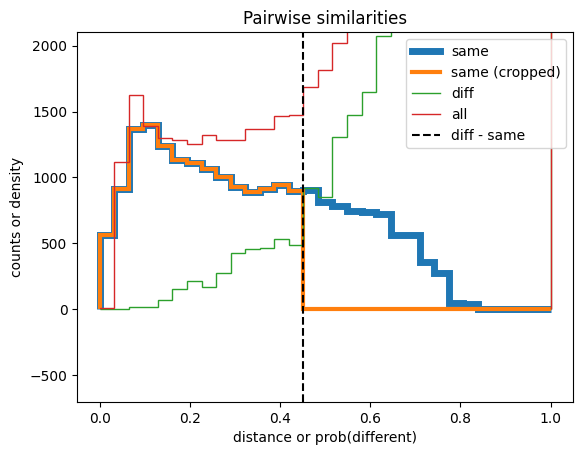

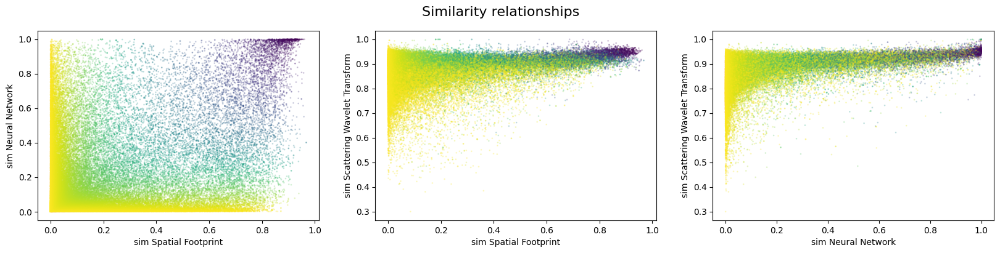

In [160]:
clusterer.plot_distSame(kwargs_makeConjunctiveDistanceMatrix=kwargs_makeConjunctiveDistanceMatrix_best)

clusterer.plot_similarity_relationships(
    plots_to_show=[1,2,3], 
    max_samples=100000,  ## Make smaller if it is running too slow
    kwargs_scatter={'s':1, 'alpha':0.2},
    kwargs_makeConjunctiveDistanceMatrix=kwargs_makeConjunctiveDistanceMatrix_best
);

##### 2. Prune the distance matrix

We can remove all connections in the distance graph with probabilities of connection of less than 50%. We estimate this cutoff distance as the cross-over point between the 'same' and 'different' distributions.

**Important parameter**\
`stringency`: This value changes the threshold for pruning the distance matrix. A higher value will result in less pruning, and a lower value will result in more pruning. The value will be multiplied by the inferred threshold to get the new one.


In [161]:
clusterer.make_pruned_similarity_graphs(
    d_cutoff=None,  ## Optionally manually specify a distance cutoff
    kwargs_makeConjunctiveDistanceMatrix=kwargs_makeConjunctiveDistanceMatrix_best,
    stringency=1.0,  ## Modifies the threshold for pruning the distance matrix. Higher values result in LESS pruning. New d_cutoff = stringency * truncated d_cutoff.
    convert_to_probability=False,    
)

Pruning similarity graphs with d_cutoff = 0.4516128897666931...


C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\scipy\sparse\_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_arrayXarray(i, j, x)


##### 3. Cluster

There are two methods for clustering: The standard method `.fit` which is based on HDBSCAN, and `.fit_sequentialHungarian` which is an algorithm that is also used by CaImAn based on the Hungarian algorithm. The standard method takes 1-20 minutes and works better when there are many sessions, the Hungarian method takes seconds and works better when there are fewer sessions (<8).

**Important parameters**:
- For standard **`.fit`** method:
1. `min_cluster_size`: If you only want ROIs clusters with at least a certain number of samples, specify here.
2. `n_iter_violationCorrection`: This parameter controls how fast this step takes. Turning it down has mild effects on quality. We use around ***6***.

- For **`.fit_sequentialHungarian`** method:
1. `thresh_cost`: Determines the threshold of how distant two ROIs can be and still be matched. Smaller value is more stringent.


In [162]:
if data.n_sessions >= 6:
    labels = clusterer.fit(
        d_conj=clusterer.dConj_pruned,  ## Input distance matrix
        session_bool=data.session_bool,  ## Boolean array of which ROIs belong to which sessions
        min_cluster_size=2,  ## Minimum number of ROIs that can be considered a 'cluster'
        n_iter_violationCorrection=6,  ## Number of times to redo clustering sweep after removing violations
        split_intraSession_clusters=True,  ## Whether or not to split clusters with ROIs from the same session
        cluster_selection_method='leaf',  ## (advanced) Method of cluster selection for HDBSCAN (see hdbscan documentation)
        d_clusterMerge=None,  ## Distance below which all ROIs are merged into a cluster
        alpha=0.999,  ## (advanced) Scalar applied to distance matrix in HDBSCAN (see hdbscan documentation)
        discard_failed_pruning=True,  ## (advanced) Whether or not to set all ROIs that could be separated from clusters with ROIs from the same sessions to label=-1
        n_steps_clusterSplit=100,  ## (advanced) How finely to step through distances to remove violations
    )

else:
    labels = clusterer.fit_sequentialHungarian(
        d_conj=clusterer.dConj_pruned,  ## Input distance matrix
        session_bool=data.session_bool,  ## Boolean array of which ROIs belong to which sessions
        thresh_cost=0.8,  ## Threshold (default = 0.4)
    )

Fitting with HDBSCAN and splitting clusters with multiple ROIs per session


  0%|          | 0/6 [00:00<?, ?it/s]

Initial number of violating clusters: 185


C:\Users\Samuel\anaconda3\envs\ROICaT-gpu\Lib\site-packages\scipy\sparse\_index.py:142: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_arrayXarray_sparse(i, j, x)


Initial number of violating clusters: 83
Initial number of violating clusters: 59
Initial number of violating clusters: 50
Initial number of violating clusters: 55
Initial number of violating clusters: 50


##### 4. Quality metrics

Compute various quality scores for each cluster and each ROI.

In [163]:
## SKIP THIS STEP FOR VERY LARGE DATASETS
quality_metrics = clusterer.compute_quality_metrics();

## Collect results

1. Make different versions of the labels for convenience.
2. Put all the useful results and info into a dictionary to save later
3. Put all the class objects from the run into a dictionary to save later

In [164]:
# labels_squeezed, labels_bySession, labels_bool, labels_bool_bySession, labels_dict = roicat.tracking.clustering.make_label_variants(labels=labels, n_roi_bySession=data.n_roi)
# 
# ## NEW STRUCTURES
# 
# results_clusters = {
#     'labels': labels_squeezed,
#     'labels_bySession': labels_bySession,
#     'labels_dict': labels_dict,
#     'quality_metrics': quality_metrics,
# }
# 
# results_all = {
#     "clusters":{
#         "labels": roicat.util.JSON_List(labels_squeezed),
#         "labels_bySession": roicat.util.JSON_List(labels_bySession),
#         "labels_bool": labels_bool,
#         "labels_bool_bySession": labels_bool_bySession,
#         "labels_dict": roicat.util.JSON_Dict(labels_dict),
#         "quality_metrics": roicat.util.JSON_Dict(clusterer.quality_metrics) if hasattr(clusterer, 'quality_metrics') else None,
#     },
#     "ROIs": {
#         "ROIs_aligned": aligner.ROIs_aligned,
#         "ROIs_raw": data.spatialFootprints,
#         "frame_height": data.FOV_height,
#         "frame_width": data.FOV_width,
#         "idx_roi_session": np.where(data.session_bool)[1],
#         "n_sessions": data.n_sessions,
#     },
#     "input_data": {
#         "paths_stat": data.paths_stat,
#         "paths_ops": data.paths_ops,
#     },
# }
# 
# run_data = {
#     'data': data.__dict__,
#     'aligner': aligner.__dict__,
#     'blurrer': blurrer.__dict__,
#     'roinet': roinet.__dict__,
#     'swt': swt.__dict__,
#     'sim': sim.__dict__,
#     'clusterer': clusterer.__dict__,
# }
# 
# params_used = {name: mod['params'] for name, mod in run_data.items()}
# 

In [165]:
labels_squeezed, labels_bySession, labels_bool, labels_bool_bySession, labels_dict = roicat.tracking.clustering.make_label_variants(labels=labels, n_roi_bySession=data.n_roi)

# OLD VERSION
results = {
   "clusters":{
       "labels": labels_squeezed,
       "labels_bySession": labels_bySession,
       "labels_bool": labels_bool,
       "labels_bool_bySession": labels_bool_bySession,
       "labels_dict": labels_dict,
   },
   "ROIs": {
       "ROIs_aligned": aligner.ROIs_aligned,
       "ROIs_raw": data.spatialFootprints,
       "frame_height": data.FOV_height,
       "frame_width": data.FOV_width,
       "idx_roi_session": np.where(data.session_bool)[1],
       "n_sessions": data.n_sessions,
   },
   "input_data": {
       "paths_stat": data.paths_stat,
       "paths_ops": data.paths_ops,
   },
   "quality_metrics": clusterer.quality_metrics if hasattr(clusterer, 'quality_metrics') else None,
}

run_data = copy.deepcopy({
   'data': data.serializable_dict,
   'aligner': aligner.serializable_dict,
   'blurrer': blurrer.serializable_dict,
   'roinet': roinet.serializable_dict,
   'swt': swt.serializable_dict,
   'sim': sim.serializable_dict,
   'clusterer': clusterer.serializable_dict,
})

# Visualize results

In [166]:
print(f'Number of clusters: {len(np.unique(results["clusters"]["labels"]))}')
print(f'Number of discarded ROIs: {(np.array(results["clusters"]["labels"])==-1).sum()}')

Number of clusters: 1437
Number of discarded ROIs: 6053


Look at some of the distributions of the quality metrics.
- Silhouette score is a particularly useful one for this type of clustering. Learn more here: https://en.wikipedia.org/wiki/Silhouette_(clustering)
- We also define a handy 'confidence' variable which is a nice heuristic you can use for thresholding for inclusion criteria
- Note that the `sample_silhouette` score is a per-sample (per-ROI) score. So it can actually be used to remove / subselect ROIs from clusters.

A good rule of thumb is to use an inclusion criteria of:
- `sample_silhouette` > 0.1
- `cluster_silhouette` > 0.2

In [167]:
#roicat.tracking.clustering.plot_quality_metrics(quality_metrics=quality_metrics, labels=labels_squeezed, n_sessions=data.n_sessions);

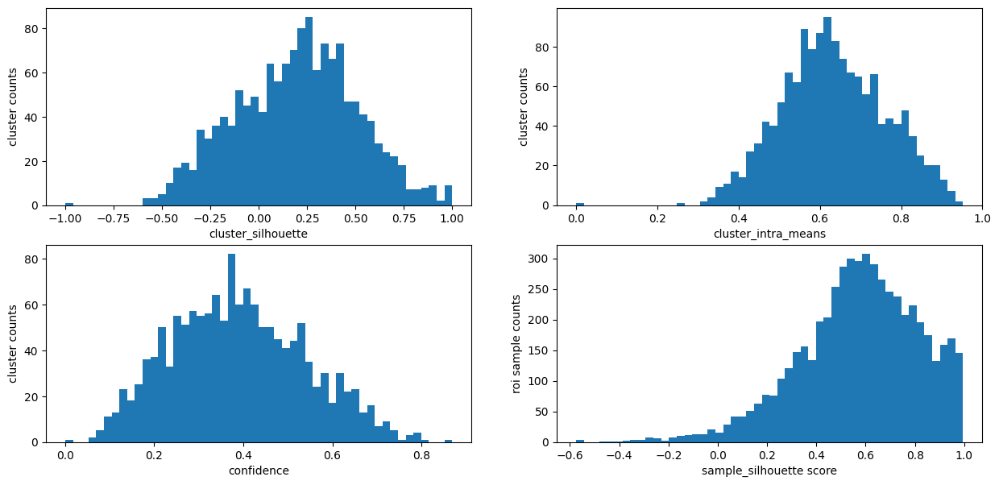

In [168]:
confidence = (((np.array(results['quality_metrics']['cluster_silhouette']) + 1) / 2) * np.array(results['quality_metrics']['cluster_intra_means']))

fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15,7))

axs[0,0].hist(results['quality_metrics']['cluster_silhouette'], 50);
axs[0,0].set_xlabel('cluster_silhouette');
axs[0,0].set_ylabel('cluster counts');

axs[0,1].hist(results['quality_metrics']['cluster_intra_means'], 50);
axs[0,1].set_xlabel('cluster_intra_means');
axs[0,1].set_ylabel('cluster counts');

axs[1,0].hist(confidence, 50);
axs[1,0].set_xlabel('confidence');
axs[1,0].set_ylabel('cluster counts');

axs[1,1].hist(np.array(results['quality_metrics']['sample_silhouette'])[np.array(results['clusters']['labels'])!=-1], 50);
axs[1,1].set_xlabel('sample_silhouette score');
axs[1,1].set_ylabel('roi sample counts');

ff = Path('G:/Shared drives/WG-Mesoscope/Chronic/'+subject).resolve()
#fig.savefig(ff / (fov_name + '_QualityMetrics' + '.svg'),bbox_inches='tight')
#fig.savefig(ff / (fov_name + '_QualityMetrics' + '.png'),bbox_inches='tight')

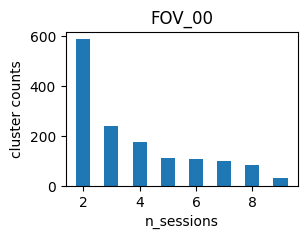

In [169]:
_, counts = np.unique(results['clusters']['labels'], return_counts=True)

fig = plt.figure(figsize=(3,2))
plt.hist(counts, results['ROIs']['n_sessions']*2 - 3, range=(1.75, results['ROIs']['n_sessions']+0.25));
plt.xlabel('n_sessions'), plt.ylabel('cluster counts');
plt.title(fov_name)

#ff = Path('C:/Users/Samuel/Documents/2PI/'+subject+'/chronic').resolve()
ff = Path('G:/Shared drives/WG-Mesoscope/Chronic/'+subject).resolve()
#fig.savefig(ff / (fov_name + '_clusterCounts' + '.svg'),bbox_inches='tight')
#fig.savefig(ff / (fov_name + '_clusterCounts' + '.png'),bbox_inches='tight')

In [170]:
#load iscell arrays 
paths_allStat = results['input_data']['paths_stat']
paths_allIscell = list(np.unique([(Path(path) / '..' / 'iscell.npy').resolve() for path in paths_allStat]))
iscell_byS = [np.load(path)[:,0] for path in paths_allIscell]
iscell_all = np.concatenate(iscell_byS)

Look at a color visualization of the results. ROIs of the same color are considered a part of the same cluster. The colors are assigned randomly.


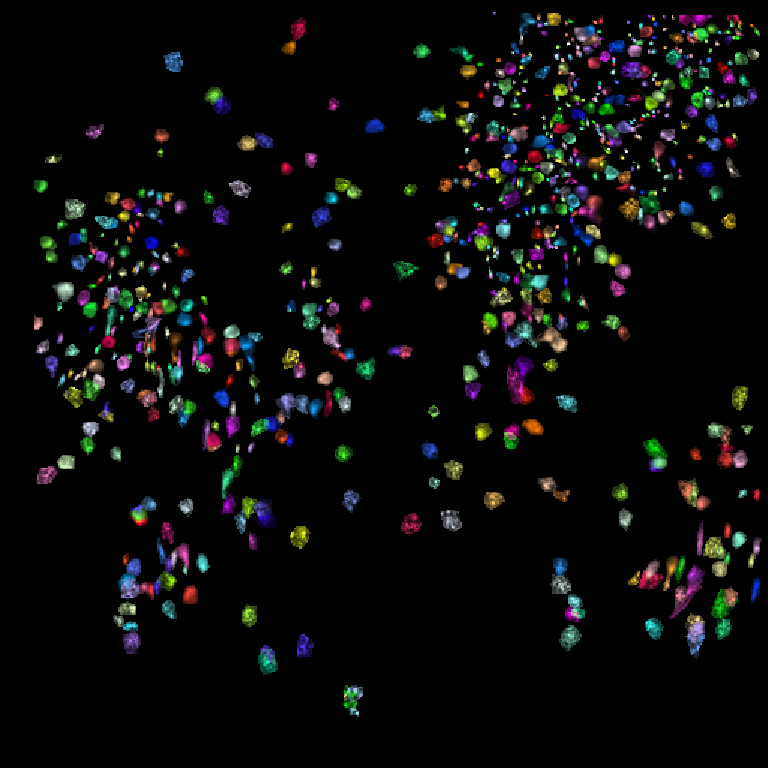

In [171]:
FOV_clusters = roicat.visualization.compute_colored_FOV(
    spatialFootprints=[r.power(1.0) for r in results['ROIs']['ROIs_aligned']],  ## Spatial footprint sparse arrays
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    labels=results["clusters"]["labels_bySession"],  ## cluster labels
#     labels=(np.array(results["clusters"]["labels"])!=-1).astype(np.int64),  ## cluster labels
    # alphas_labels=confidence*1.5,  ## Set brightness of each cluster based on some 1-D array
#     alphas_labels=(clusterer.quality_metrics['cluster_silhouette'] > 0) * (clusterer.quality_metrics['cluster_intra_means'] > 0.4),
#     alphas_sf=clusterer.quality_metrics['sample_silhouette'],  ## Set brightness of each ROI based on some 1-D array
)

roicat.visualization.display_toggle_image_stack(
    FOV_clusters, 
    image_size=1.5,
#     clim=[0,1.0],
)

Visualize the images of ROIs from the same cluster

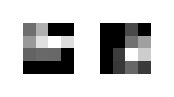

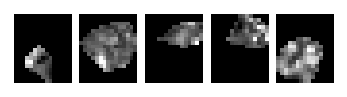

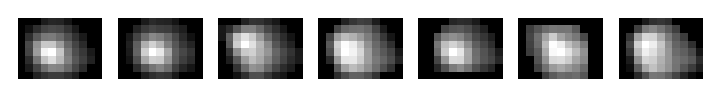

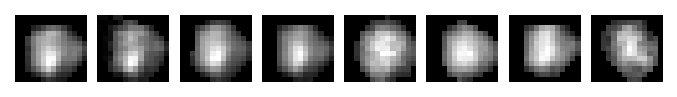

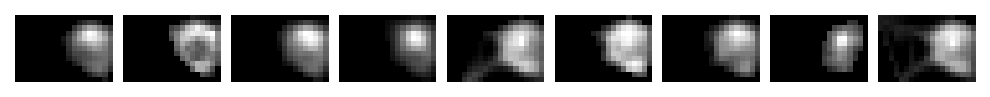

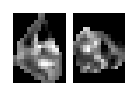

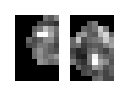

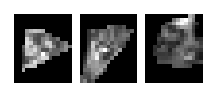

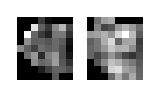

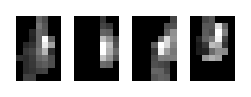

In [172]:
roicat.visualization.display_cropped_cluster_ims(
    spatialFootprints=results['ROIs']['ROIs_aligned'],
    labels=np.array(results["clusters"]["labels"]),
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    n_labels_to_display=10,    
)

# Save results

In [173]:
#dir_save = Path('C:/Users/Samuel/Documents/2PI/'+subject+'/chronic').resolve()
dir_save = Path('G:/Shared drives/WG-Mesoscope/Chronic/'+subject).resolve()
#name_save = Path(dir_allOuterFolders).resolve().name
name_save = fov_name

path_save = dir_save / (name_save + '.ROICaT.tracking.results' + '.pkl')
print(f'path_save: {path_save}')

path_save: G:\Shared drives\WG-Mesoscope\Chronic\SP065\FOV_00.ROICaT.tracking.results.pkl


In [174]:
roicat.helpers.pickle_save(
    obj=results,
    filepath=path_save,
    mkdir=True,
)

roicat.helpers.pickle_save(
    obj=run_data,
    filepath=str(dir_save / (name_save + '.ROICaT.tracking.rundata' + '.pkl')),
    mkdir=True,
)


Optionally save the FOV_clusters images as a GIF

In [175]:
gif_name_save = name_save + '_clusters_iscell.gif'
roicat.helpers.save_gif(
    array=roicat.helpers.add_text_to_images(
        images=[(f * 255).astype(np.uint8) for f in FOV_clusters], 
        text=[[f"{ii}",] for ii in range(len(FOV_clusters))], 
        font_size=1,
        line_width=2,
        position=(10, 30),
    ), 
    path=str(Path(dir_save).resolve() / gif_name_save),
    frameRate=2.0,
    loop=0,
)

Optionally save the motion-registered, augmented mean images as a GIF

In [176]:
gif_name_save = name_save + '_meanImgs.gif'
roicat.helpers.save_gif(
    array=roicat.helpers.add_text_to_images(
        images=[(f * 4).astype(np.uint8) for f in aligner.ims_registered_nonrigid], 
        text=[[f"{ii}",] for ii in range(len(FOV_clusters))], 
        font_size=1,
        line_width=2,
        position=(10, 30),
    ), 
    path=str(Path(dir_save).resolve() / gif_name_save),
    frameRate=2.0,
    loop=0,
)

Optionally save results as a matlab file.

In [177]:
roicat.helpers.matlab_save(
    obj=results,
    filepath=dir_save / (name_save + '.ROICaT.tracking.results.mat'),
)

In [ ]:
#

# Playground

In [51]:
FOV_clusters = roicat.visualization.compute_colored_FOV(
    spatialFootprints=[r.power(0.7) for r in results['ROIs']['ROIs_aligned']],  ## Spatial footprint sparse arrays
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    labels=results["clusters"]["labels_bySession"],  ## cluster labels
    # alphas_labels=confidence > 0.5,  ## Set brightness of each cluster based on some 1-D array
    alphas_labels=(clusterer.quality_metrics['cluster_silhouette'] > 0) * (clusterer.quality_metrics['cluster_intra_means'] > 0),
    # alphas_sf=clusterer.quality_metrics['sample_silhouette']>0.5,  ## Set brightness of each ROI based on some 1-D array
)

c:\users\samuel\documents\github\roicat\roicat\visualization.py:241: RuntimeWarning: divide by zero encountered in divide
  rois = rois.multiply(1.0/rois.max(1).A).power(1)



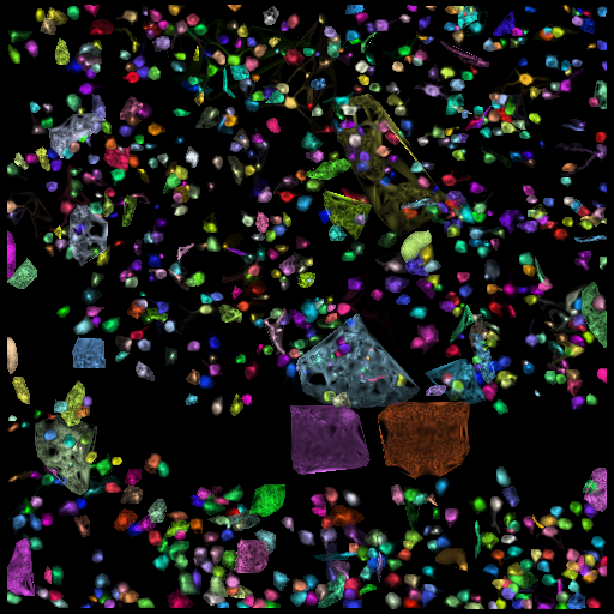

In [52]:
roicat.visualization.display_toggle_image_stack(
    FOV_clusters, 
    image_size=1.2,
#     clim=[0,1.0],
)

In [57]:
# #now only plot those ROIs for which iscell=True
FOV_clusters_iscell = roicat.visualization.compute_colored_FOV(
    spatialFootprints=[r.power(0.7) for r in results['ROIs']['ROIs_aligned']],  ## Spatial footprint sparse arrays
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    labels=roicat.util.mask_UCIDs_with_iscell(results['clusters']['labels_bySession'],iscell_all),  ## cluster labels
    # alphas_labels=confidence*1.5,  ## Set brightness of each cluster based on some 1-D array
    #alphas_labels=(clusterer.quality_metrics['cluster_silhouette'] > 0) * (clusterer.quality_metrics['cluster_intra_means'] > 0.4),
#     alphas_sf=clusterer.quality_metrics['sample_silhouette'],  ## Set brightness of each ROI based on some 1-D array
)

IndexError: boolean index did not match indexed array along dimension 0; dimension is 1527 but corresponding boolean dimension is 29725

KeyboardInterrupt: 

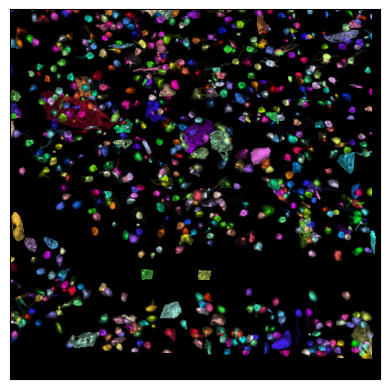

In [107]:
plt_suffix = '_clusters_D'
for i,f in enumerate(FOV_clusters):
    #plt.figure
    fig = plt.imshow(f)
    fig.axes.get_xaxis().set_visible(False)
    fig.axes.get_yaxis().set_visible(False)
    #plt.show()
    plt.savefig(ff / (fov_name + plt_suffix + str(i) + '.svg'),bbox_inches='tight')
    plt.savefig(ff / (fov_name + plt_suffix + str(i) + '.png'), transparent=True, bbox_inches='tight', dpi=150)

In [ ]:
plt_suffix = '_meanImg_reg_D'
for i,f in enumerate(aligner.ims_registered_nonrigid):
    #plt.figure
    fig = plt.imshow(f, cmap='gray')
    fig.axes.get_xaxis().set_visible(False)
    fig.axes.get_yaxis().set_visible(False)
    #plt.show()
    plt.savefig(ff / (fov_name + plt_suffix + str(i) + '.svg'),bbox_inches='tight')
    plt.savefig(ff / (fov_name + plt_suffix + str(i) + '.png'), transparent=True, bbox_inches='tight', dpi=150)

In [326]:
results['input_data']['paths_stat'][0]

'\\\\128.40.198.163\\ibldata\\Subjects\\SP058\\2024-06-18\\002\\alf\\FOV_04\\_suite2p_ROIData.raw\\stat.npy'

In [324]:
data = roicat.data_importing.Data_suite2p(
    paths_statFiles=results['input_data']['paths_stat'],
    paths_opsFiles=results['input_data']['paths_ops'],
    um_per_pixel=1.2,  ## IMPORTANT PARAMETER
    new_or_old_suite2p='new',
    type_meanImg='meanImgE',
#     FOV_images=FOVs_mixed,

    verbose=True,
)

c:\users\samuel\documents\github\roicat\roicat\util.py:333: UserWarning: RH WARNING: unable to get gcc version. Got error: [WinError 2] The system cannot find the file specified
  warnings.warn(f'RH WARNING: unable to get gcc version. Got error: {e}')


Starting: Importing FOV images from ops files
Completed: Set FOV_height and FOV_width successfully.
Completed: Imported 24 FOV images.
Completed: Set FOV_images for 24 sessions successfully.
Importing spatial footprints from stat files.


100%|██████████████████████████████████████████████████████████████████████████████████| 24/24 [00:13<00:00,  1.82it/s]


Imported 24 sessions of spatial footprints into sparse arrays.
Completed: Set spatialFootprints for 24 sessions successfully.
Completed: Created session_bool.
Completed: Created centroids.
Staring: Creating centered ROI images from spatial footprints...
Completed: Created ROI images.


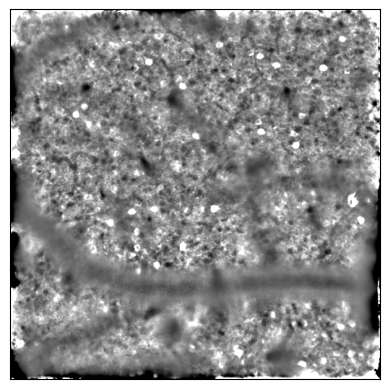

In [325]:
plt_suffix = '_meanImg_D'
for i,f in enumerate(data.FOV_images):
    #plt.figure
    fig = plt.imshow(f, cmap='gray')
    fig.axes.get_xaxis().set_visible(False)
    fig.axes.get_yaxis().set_visible(False)
    #plt.show()
    plt.savefig(ff / (fov_name + plt_suffix + str(i) + '.svg'),bbox_inches='tight')
    plt.savefig(ff / (fov_name + plt_suffix + str(i) + '.png'), transparent=True, bbox_inches='tight', dpi=150)

In [9]:
unique, counts = np.unique(results["clusters"]["labels"], return_counts=True)

old_labels = results["clusters"]["labels"]
new_labels = np.full(np.shape(old_labels), -1)
#for i in unique[counts==len(results["clusters"]["labels_bySession"])]:
for i in unique[counts>=24]:
    new_labels[old_labels==i] = i

#sub-select
new_labels_sel = new_labels.copy()
#iROI = [944,1001,1411,1474]
#new_labels_sel[np.isin(new_labels,iROI,invert=True)] = -1

In [10]:
from scipy.ndimage import center_of_mass
im = np.array([[np.nan,np.nan],[np.nan,np.nan]])
comy, comx = center_of_mass(im)
np.all(im==0)

False

In [12]:
display_cropped_cluster_ims(
    spatialFootprints=results['ROIs']['ROIs_aligned'],
    meanImgs=rundata['aligner']['ims_registered_nonrigid'],
    #labels=results["clusters"]["labels"],
    labels=new_labels_sel,
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    n_labels_to_display=10,  
    #sort_by_count=True,
    display_as_matrix=True,
)

TypeError: display_cropped_cluster_ims() missing 2 required positional arguments: 'meanImgs_masks' and 'clusters_toexclude'

Visualize the images of ROIs from the same cluster

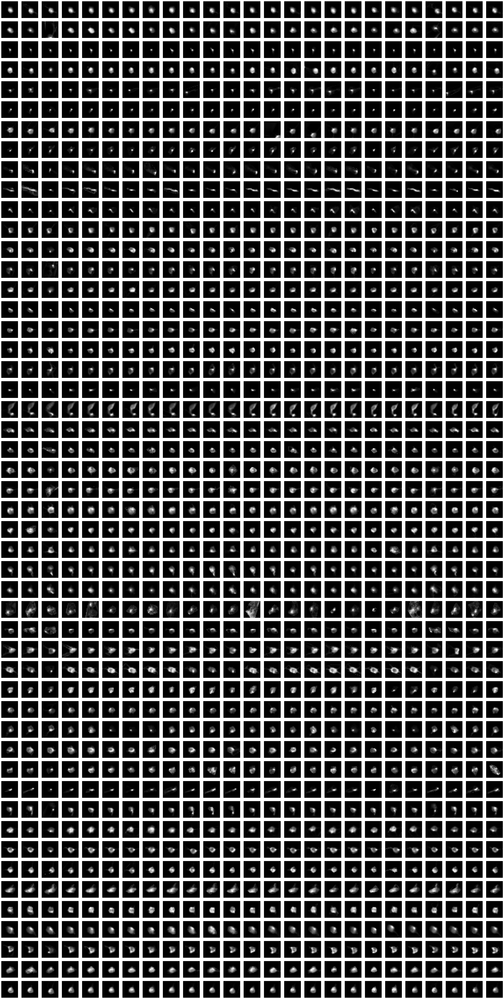

In [58]:
roicat.visualization.display_cropped_cluster_ims(
    spatialFootprints=results['ROIs']['ROIs_aligned'],
    #labels=results["clusters"]["labels"],
    labels=labels,
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    n_labels_to_display=50,  
    sort_by_count=True,
    display_as_matrix=True,
)

In [26]:
def crop_cluster_im_square(im: np.ndarray, center: np.ndarray, sz: int=25) -> np.ndarray:
    """
    Crops the image to a square of fixed size, centered around its center-of-mass. 
    SP 2024

    Args:
        im (np.ndarray):  
            Image to crop. (shape: *(H, W)*) 
        center (np.ndarray):
            center coords y, x (shape: (2))
        sz (int):
            width/height of square in pixels

    Returns:
        (np.ndarray): 
            im_out (np.ndarray): 
                Cropped image. (shape: *(sz, sz)*) 
    """
    from scipy.ndimage import center_of_mass

    if sz % 2 == 0:
        sz_odd = sz-1
    else:
        sz_odd = sz

    if np.all(np.isnan(im)) or np.all(im==0):
        im_out = np.zeros((sz,sz))
    else:
        com_y = center[0]
        com_x = center[1]
        # Define edges of cropping square
        y_min = max(0, int(com_y) - (sz_odd+1) // 2)
        x_min = max(0, int(com_x) - (sz_odd+1) // 2)
        y_max = min(im.shape[0], int(com_y) + (sz_odd+1) // 2)
        x_max = min(im.shape[1], int(com_x) + (sz_odd+1) // 2)
        # Crop the image
        im_out = im[y_min:y_max, x_min:x_max]

    # If the cropped region is smaller than the requested size, pad it
    pad_y = sz - im_out.shape[0]
    pad_x = sz - im_out.shape[1]
    #print(pad_y)
    #print(pad_x)
    #if pad_y > 0 or pad_x > 0:
    #    im_out = np.pad(im_out, ((pad_y,0), (pad_x,0)), mode='constant', constant_values=0)

    return im_out

def display_cropped_cluster_ims(
    spatialFootprints: list[np.ndarray], 
    meanImgs: list[np.ndarray],
    meanImgs_masks: list[np.array],
    labels: np.ndarray, 
    #sortIdx: np.ndarray,
    clusters_toexclude: np.ndarray,
    #labels_toexclude: np.ndarray = np.zeros(np.shape(labels), dtype=bool),
    FOV_height: int = 512, 
    FOV_width: int = 1024,
    n_labels_to_display: int = 100,
    display_as_matrix: bool = False,
) -> None:
    """
    Displays the cropped cluster images.
    RH 2023
    SP 2024-10 can now also display as a matrix of masks of fixed size, and sort by cluster counts (descending)

    Args:
        spatialFootprints (List[np.ndarray]): 
            List of spatial footprints. Each footprint is a 2D array
            representing one region. (shape of each footprint: *(H, W)*)
        labels (np.ndarray): 
            Labels for each region of interest (ROI). (shape: *(n,)*)
        FOV_height (int): 
            Height of the field of view. (Default is *512*)
        FOV_width (int): 
            Width of the field of view. (Default is *1024*)
        n_labels_to_display (int): 
            Number of labels to display. (Default is *100*)
        sort_by_count (bool):
            Whether or not to sort by descending nr of tracked days. (Default is False)
        display_as_matrix (bool):
            Whether or not to display as a matrix with square masks (Default is False)
    """
    import scipy.sparse
    from scipy.ndimage import center_of_mass

    labels_byS = labels
    if isinstance(labels, list):
        labels = np.concatenate(labels).ravel()
    
    #if len(labels_toexclude) != len(labels):
    #if not labels_toexclude.all():
    #    labels_toexclude = np.zeros(np.shape(labels), dtype=bool)
    
    labels_unique, labels_count = np.unique(labels[labels>-1],return_counts=True)
    #labels_unique = labels_unique[labels_count<=0.5*max(labels_count))
    #labels_count_new = labels_count(labels_count<=0.5*max(labels_count))
    labels_unique = labels_unique[np.argsort(-labels_count)]
    #if isinstance(sortIdx,np.ndarray):
    #    labels_unique = labels_unique[sortIdx]
    #labels_unique = labels_unique[1100:]
    #labels_unique = np.array([3, 1163, 1251, 1276, 1322])

    ROI_ims_sparse = scipy.sparse.vstack(spatialFootprints)
    ROI_ims_sparse = ROI_ims_sparse.multiply( ROI_ims_sparse.max(1).power(-1) ).tocsr()

    labels_bool_t = scipy.sparse.vstack([scipy.sparse.csr_matrix(labels==u) for u in labels_unique]).tocsr()
    labels_bool_t = labels_bool_t[:n_labels_to_display]

    if display_as_matrix:

        fig, axs = plt.subplots(n_labels_to_display,len(labels_byS),figsize=(len(labels_byS)*2,n_labels_to_display*2))
        for i,lab in enumerate(labels_bool_t):
            idx = lab.indices
            com_y, com_x = center_of_mass(np.array(ROI_ims_sparse[idx].mean(axis=0).reshape(FOV_height, FOV_width)))
            if isinstance(labels_byS, list):
                cnt = 0
                for j in np.arange(len(labels_byS)):
                    mIm = crop_cluster_im_square(meanImgs[j],np.array([com_y, com_x]))
                    mIm_mask = crop_cluster_im_square(meanImgs_masks[j],np.array([com_y, com_x]))
                    mIm_mask_alpha = 0.5 * ((mIm_mask - mIm_mask.min()) / (mIm_mask.max() - mIm_mask.min())+1e-8)
                    green_overlay = np.zeros((mIm_mask.shape[0], mIm_mask.shape[1], 4))  # RGBA image
                    green_overlay[..., 1] = 1.0  # Green channel to maximum
                    green_overlay[..., 3] = mIm_mask_alpha    
                    axs[i,j].imshow(mIm, cmap='gray')
                    axs[i,j].imshow(green_overlay)  #all other ROI masks
                    col_overlay = np.zeros((mIm.shape[0], mIm.shape[1], 4))  # RGBA image
                    if np.isin(labels_unique[i],labels_byS[j]):
                        im = ROI_ims_sparse[idx[cnt]].toarray().reshape(FOV_height, FOV_width)
                        im = crop_cluster_im_square(im,np.array([com_y, com_x]))
                        im_alpha = 0.5 * ((im - im.min()) / (im.max() - im.min())+1e-8)
                        if clusters_toexclude[j][labels_unique[i]]:
                            col_overlay[..., 2] = 1.0  # Blue channel to maximum
                        else:
                            col_overlay[..., 0] = 1.0  # Red channel to maximum
                        col_overlay[..., 3] = im_alpha          
                        cnt += 1
                    axs[i,j].imshow(col_overlay) 
                    #axs[i,j].imshow(im, cmap='gray')
                    axs[i,j].axis("off")

            else:
                for j,im in enumerate(ROI_ims_sparse[idx]):
                    im = im.toarray().reshape(FOV_height, FOV_width)
                    #com_y, com_x = center_of_mass(im)
                    im = crop_cluster_im_square(im,np.array([com_y, com_x]))
                    mIm = crop_cluster_im_square(meanImgs[j],np.array([com_y, com_x]))
                    axs[i,j].imshow(mIm, cmap='gray')
                    im_alpha = 0.5 * ((im - im.min()) / (im.max() - im.min()))
                    red_overlay = np.zeros((im.shape[0], im.shape[1], 4))  # RGBA image
                    red_overlay[..., 0] = 1.0  # Red channel to maximum
                    red_overlay[..., 3] = im_alpha # Alpha channel proportional to cropped_rois
                    axs[i,j].imshow(red_overlay)  # red mask for the ROIs overlay
                    #axs[i,j].imshow(im, cmap='gray')
                    axs[i,j].axis("off")

In [317]:
def display_cropped_cluster_ims_QM(
    spatialFootprints: list[np.ndarray], 
    meanImgs: list[np.ndarray],
    #meanImgs_masks: list[np.array],
    labels: np.ndarray, 
    qm: np.ndarray,
    FOV_height: int = 512, 
    FOV_width: int = 1024,
    n_labels_to_display: int = 100,
) -> None:
    """
    Displays the cropped cluster images.
    RH 2023
    SP 2024-10 can now also display as a matrix of masks of fixed size, and sort by cluster counts (descending)

    Args:
        spatialFootprints (List[np.ndarray]): 
            List of spatial footprints. Each footprint is a 2D array
            representing one region. (shape of each footprint: *(H, W)*)
        labels (np.ndarray): 
            Labels for each region of interest (ROI). (shape: *(n,)*)
        FOV_height (int): 
            Height of the field of view. (Default is *512*)
        FOV_width (int): 
            Width of the field of view. (Default is *1024*)
        n_labels_to_display (int): 
            Number of labels to display. (Default is *100*)
        sort_by_count (bool):
            Whether or not to sort by descending nr of tracked days. (Default is False)
        display_as_matrix (bool):
            Whether or not to display as a matrix with square masks (Default is False)
    """
    import scipy.sparse
    from scipy.ndimage import center_of_mass

    labels_byS = labels
    if isinstance(labels, list):
        labels = np.concatenate(labels).ravel()
    
    #if len(labels_toexclude) != len(labels):
    #if not labels_toexclude.all():
    #    labels_toexclude = np.zeros(np.shape(labels), dtype=bool)
    
    labels_unique, labels_count = np.unique(labels[labels>-1],return_counts=True)
    #labels_unique = labels_unique[labels_count<=0.5*max(labels_count))
    #labels_count_new = labels_count(labels_count<=0.5*max(labels_count))
    labels_unique = labels_unique[np.argsort(-labels_count)]
    #if isinstance(sortIdx,np.ndarray):
    #    labels_unique = labels_unique[sortIdx]
    #labels_unique = labels_unique[1100:]

    ROI_ims_sparse = scipy.sparse.vstack(spatialFootprints)
    ROI_ims_sparse = ROI_ims_sparse.multiply( ROI_ims_sparse.max(1).power(-1) ).tocsr()

    labels_bool_t = scipy.sparse.vstack([scipy.sparse.csr_matrix(labels==u) for u in labels_unique]).tocsr()
    labels_bool_t = labels_bool_t[:n_labels_to_display]

    fig, axs = plt.subplots(n_labels_to_display,len(labels_byS),figsize=(len(labels_byS)*2,n_labels_to_display*2))
    for i,lab in enumerate(labels_bool_t):
        idx = lab.indices
        com_y, com_x = center_of_mass(np.array(ROI_ims_sparse[idx].mean(axis=0).reshape(FOV_height, FOV_width)))
        cnt = 0
        for j in np.arange(len(labels_byS)):
            mIm = crop_cluster_im_square(meanImgs[j],np.array([com_y, com_x]))
            #mIm_mask = crop_cluster_im_square(meanImgs_masks[j],np.array([com_y, com_x]))
            #mIm_mask_alpha = 0.5 * ((mIm_mask - mIm_mask.min()) / (mIm_mask.max() - mIm_mask.min())+1e-8)
            #green_overlay = np.zeros((mIm_mask.shape[0], mIm_mask.shape[1], 4))  # RGBA image
            #green_overlay[..., 1] = 1.0  # Green channel to maximum
            #green_overlay[..., 3] = mIm_mask_alpha    
            axs[i,j].imshow(mIm, cmap='gray')
            #axs[i,j].imshow(green_overlay)  #all other ROI masks
            col_overlay = qm_byS[j][labels_byS[j]==labels_unique[i]]*np.ones((mIm.shape[0], mIm.shape[1], 4))  # RGBA image
            if np.isin(labels_unique[i],labels_byS[j]):
                im = ROI_ims_sparse[idx[cnt]].toarray().reshape(FOV_height, FOV_width)
                im = crop_cluster_im_square(im,np.array([com_y, com_x]))
                im_alpha = 0.5 * ((im - im.min()) / (im.max() - im.min())+1e-8)
                #if clusters_toexclude[j][labels_unique[i]]:
                #    col_overlay[..., 2] = 1.0  # Blue channel to maximum
                #else:
                #    col_overlay[..., 0] = 1.0  # Red channel to maximum
                #col_overlay[..., 3] = im_alpha          
                cnt += 1
            axs[i,j].imshow(col_overlay, cmap='coolwarm', alpha=im_alpha) 
            #axs[i,j].imshow(im, cmap='gray')
            axs[i,j].axis("off")

In [14]:
confidence = (((results['quality_metrics']['cluster_silhouette'] + 1) / 2) * results['quality_metrics']['cluster_intra_means'])

labels_unique, labels_counts = np.unique(results["clusters"]["labels"], return_counts=True)

labels = np.full(np.shape(results["clusters"]["labels"]), -1)
labels_byS = [np.full(np.shape(lb), -1) for lb in results["clusters"]["labels_bySession"]]
confidence_f = np.full(len(labels_unique)-1, -1)
for i in labels_unique[labels_counts<=len(labels_byS)]:
    labels[results["clusters"]["labels"]==i] = i
    confidence_f[i] = confidence[i]
    for j in np.arange(len(labels_byS)):
        labels_byS[j][results["clusters"]["labels_bySession"][j]==i] = i

In [23]:
labels_toexclude_bySession = np.array([[False] * len(uniqueLabels)] * len(labels_byS))
for i,iROI in enumerate(uniqueLabels):
    for iSess in range(len(labels_byS)):
        idx = labels_byS[iSess] == iROI
        if np.any(idx):
            if sum(iscell_byS[iSess][idx])<1:
                labels_toexclude_bySession[iSess][iROI] = True

In [311]:
qm_byS = [None] * len(labels_byS)
cnt = 0
qm_byS[0] = results['quality_metrics']['sample_silhouette'][:len(labels_byS[0])]
cnt = len(labels_byS[0])
for iSess in np.arange(1,len(labels_byS)):
    qm_byS[iSess] = results['quality_metrics']['sample_silhouette'][cnt+np.arange(len(labels_byS[iSess]))]
    cnt += len(labels_byS[iSess])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


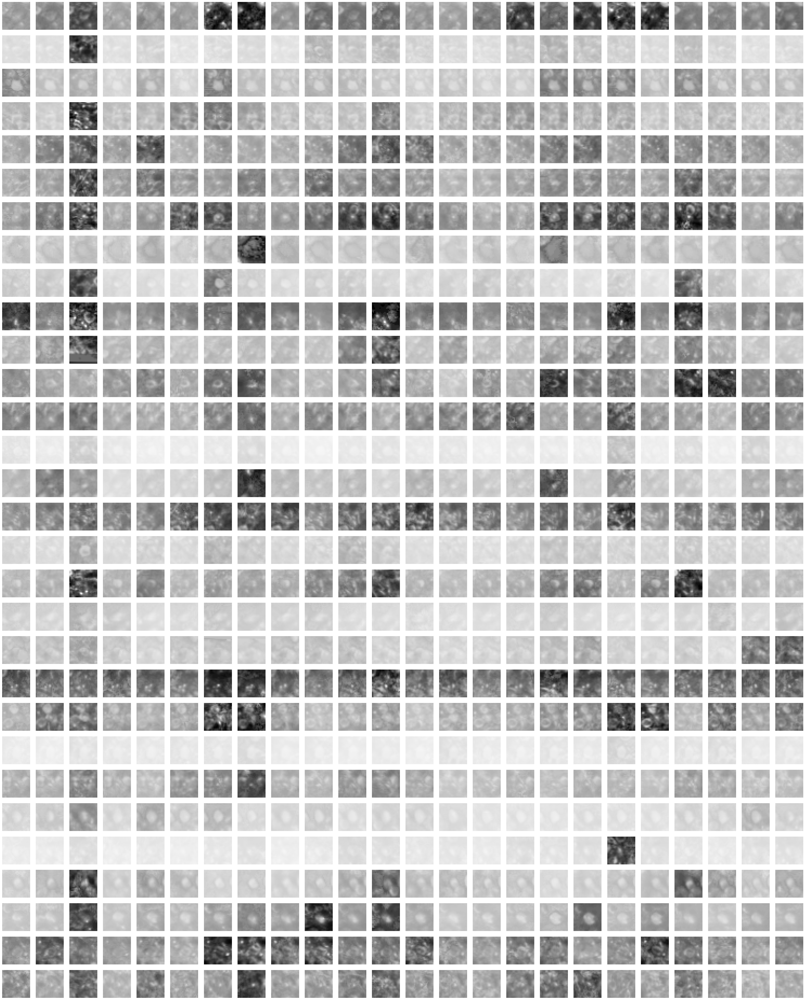

In [318]:
allROIs_maxIntensityProj = [rois.max(0).toarray().reshape(results['ROIs']['frame_height'], results['ROIs']['frame_height']) for rois in results['ROIs']['ROIs_aligned']]
clusterROIs_maxIntensityProj = [rois[labs>-1].max(0).toarray().reshape(results['ROIs']['frame_height'], results['ROIs']['frame_height']) for (rois,labs) in zip(results['ROIs']['ROIs_aligned'],results['clusters']['labels_bySession'])]

badLabels = results['quality_metrics']['cluster_silhouette'][1:] < 0.2
#sortIdx = np.argsort(-results['quality_metrics']['confidence'][1:])
#sortIdx = np.argsort(-confidence_f[1:])
display_cropped_cluster_ims_QM(
    spatialFootprints=results['ROIs']['ROIs_aligned'],
    meanImgs=rundata['aligner']['ims_registered_nonrigid'],
    #meanImgs_masks= clusterROIs_maxIntensityProj,
    #labels=results["clusters"]["labels"],
    labels=labels_byS,
    qm = qm_byS,
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    n_labels_to_display=30,  
)

In [27]:
labels_unique, labels_count = np.unique(labels[labels>-1],return_counts=True)
labels_unique = labels_unique[np.argsort(-labels_count)]
labels_unique[:10]

array([ 384, 1349, 1348, 2605,  807,  810, 1337, 1336, 1335, 1331],
      dtype=int64)

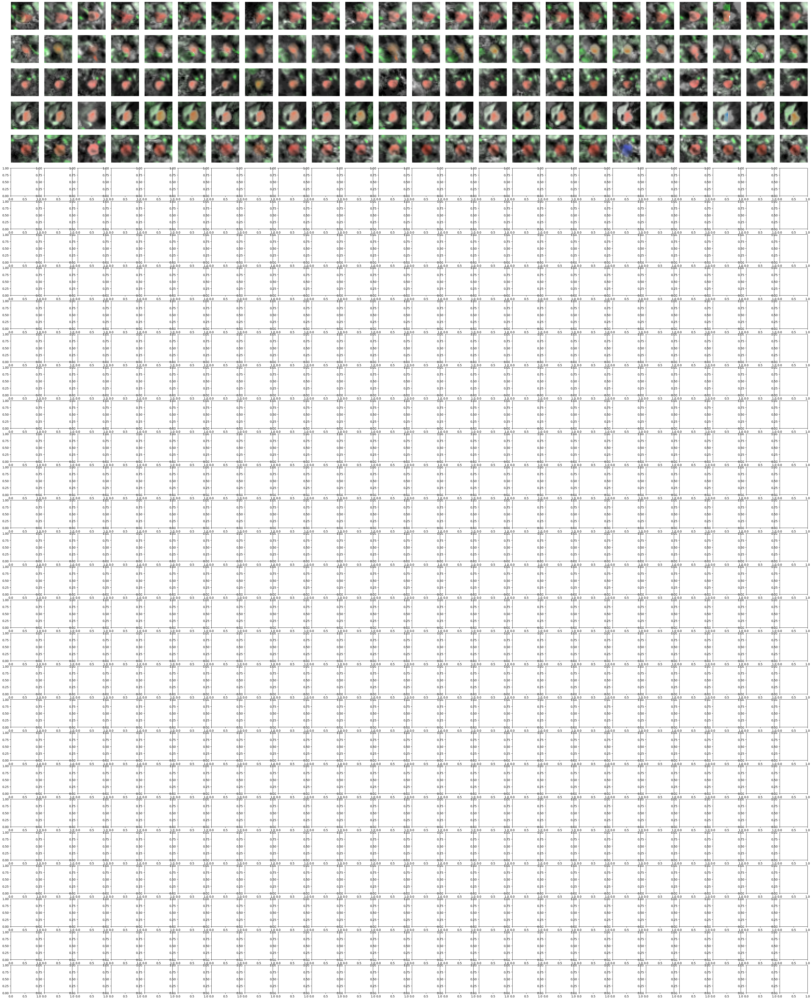

In [28]:
allROIs_maxIntensityProj = [rois.max(0).toarray().reshape(results['ROIs']['frame_height'], results['ROIs']['frame_height']) for rois in results['ROIs']['ROIs_aligned']]
clusterROIs_maxIntensityProj = [rois[labs>-1].max(0).toarray().reshape(results['ROIs']['frame_height'], results['ROIs']['frame_height']) for (rois,labs) in zip(results['ROIs']['ROIs_aligned'],results['clusters']['labels_bySession'])]

badLabels = results['quality_metrics']['cluster_silhouette'][1:] < 0.2
#sortIdx = np.argsort(-results['quality_metrics']['confidence'][1:])
#sortIdx = np.argsort(-confidence_f[1:])
display_cropped_cluster_ims(
    spatialFootprints=results['ROIs']['ROIs_aligned'],
    meanImgs=rundata['aligner']['ims_registered_nonrigid'],
    #meanImgs=allROIs_maxIntensityProj,
    meanImgs_masks= clusterROIs_maxIntensityProj,
    #labels=results["clusters"]["labels"],
    labels=labels_byS,
    #labels_toexclude = badLabels,
    clusters_toexclude = labels_toexclude_bySession,
    FOV_height=results['ROIs']['frame_height'],
    FOV_width=results['ROIs']['frame_width'],
    n_labels_to_display=30,  
    #sortIdx=sortIdx,
    display_as_matrix=True,
)